# Imports

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import seaborn as sns
import random
import os
import datetime

from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Model
from keras import layers
from PIL import Image

# Loading Dataset

In [2]:
directory = './Dataset'

images = []

for filename in os.listdir(directory):
    if filename.endswith(".jpg"):
        img_path = os.path.join(directory, filename)
        img = Image.open(img_path)
        img = img.convert("RGB")
        img = img.resize((180, 180))
        images.append(img)

print(f"Loaded {len(images)} images.")


Loaded 2000 images.


In [3]:
images = np.array(images)

# Add noise and diplay some images

In [4]:
def add_random_noise(images):
    def add_gaussian_noise(image):
        mean = 0
        sigma = random.uniform(30, 50)  # Rendre l'écart-type aléatoire
        gauss = np.random.normal(mean, sigma, image.shape).astype(np.float32)
        noisy_image = image + gauss
        noisy_image = np.clip(noisy_image, 0, 255).astype(np.uint8)
        return noisy_image

    noisy_images = []
    
    for image in images:
        noisy_image = np.copy(image)
        noisy_image = add_gaussian_noise(noisy_image)
        
        noisy_images.append(noisy_image)
    
    return np.array(noisy_images)

In [5]:
images_noisy = add_random_noise(images)

In [6]:
def display_images(original, title_1, noisy, title_2, pred=None, title_3=None):
    if pred is not None:
        col = 3
    else:
        col = 2
    fig, axes = plt.subplots(1, col, figsize=(10, 5))
    
    axes[0].imshow(original) # .astype("uint8")
    axes[0].set_title(title_1)
    axes[0].axis("off")  # Turn off axes for a cleaner look
    
    # Show the second image
    axes[1].imshow(noisy) # .astype("uint8")
    axes[1].set_title(title_2)
    axes[1].axis("off")  # Turn off axes for a cleaner look

    if pred is not None:
        # Show the second image
        axes[2].imshow(pred.astype("uint8"))
        axes[2].set_title(title_3)
        axes[2].axis("off")  # Turn off axes for a cleaner look
        
    
    # Display the images
    plt.show()

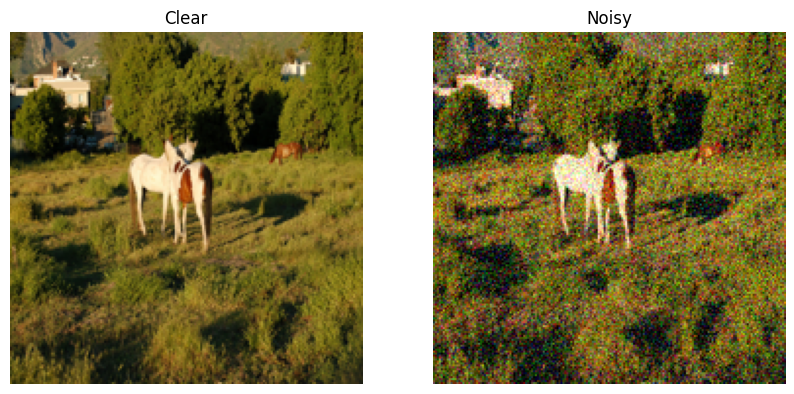

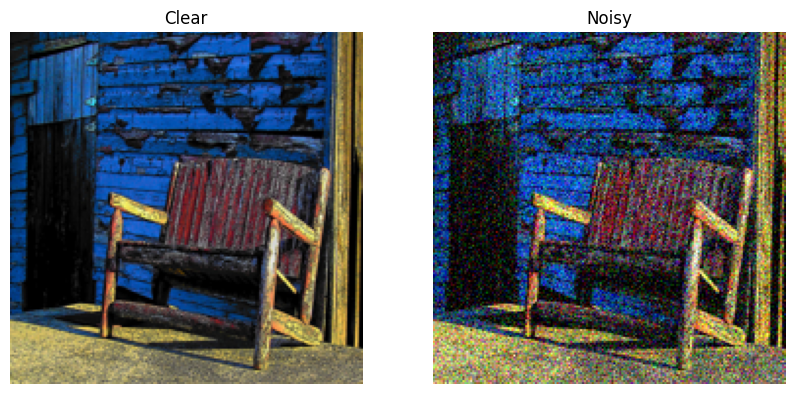

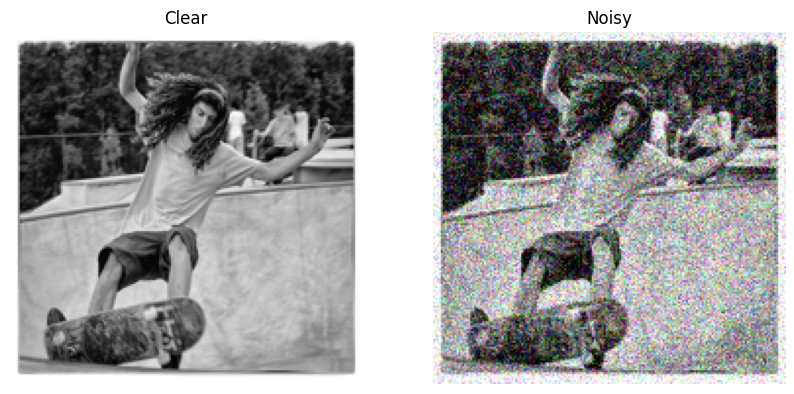

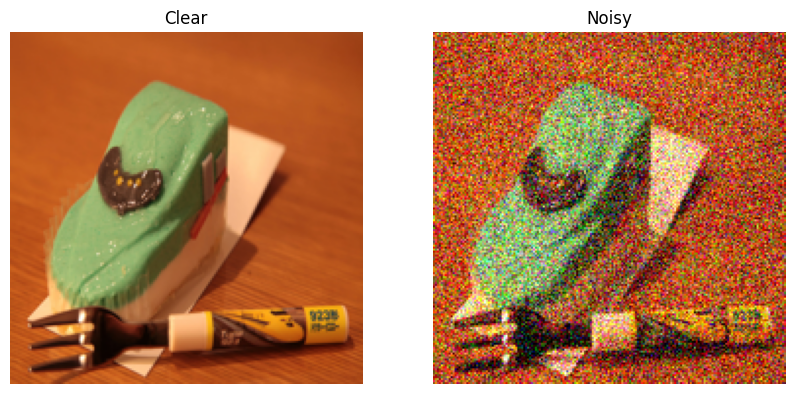

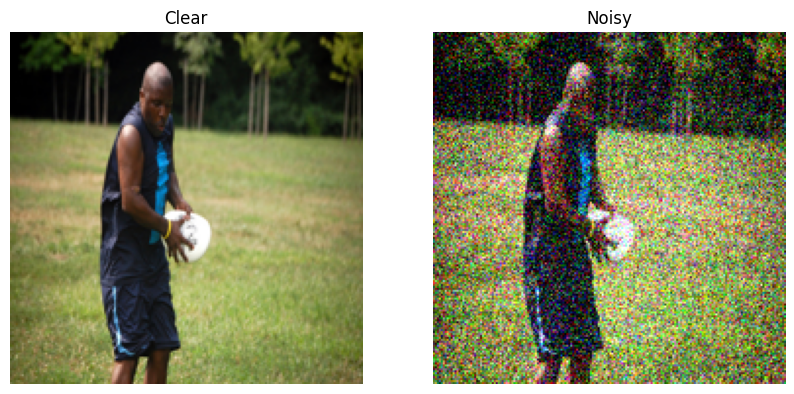

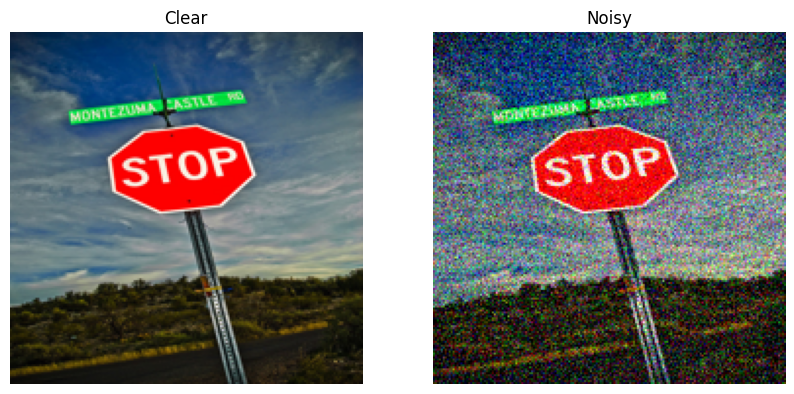

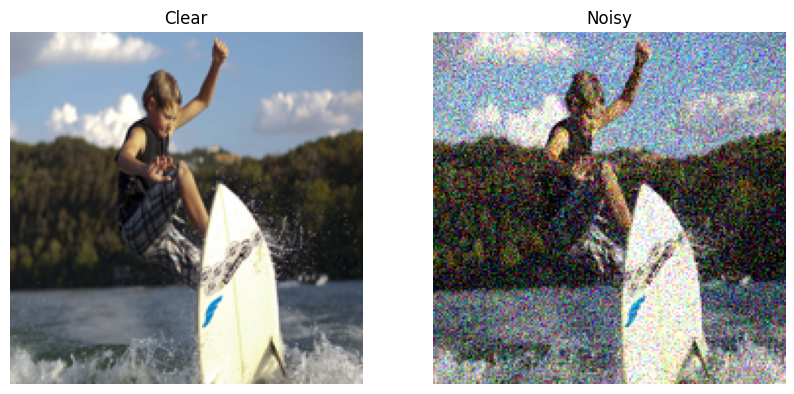

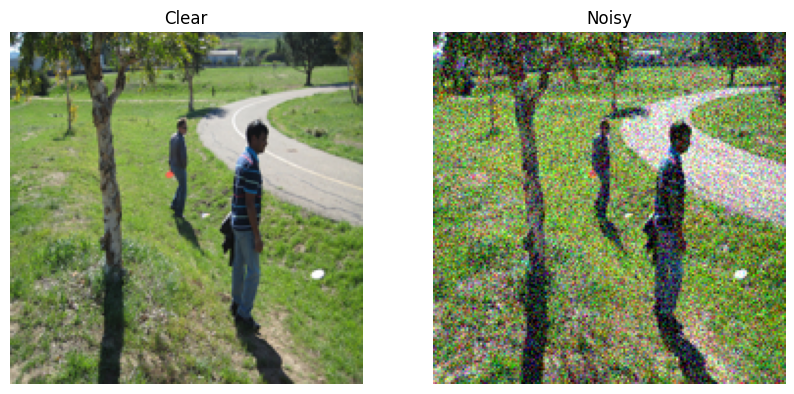

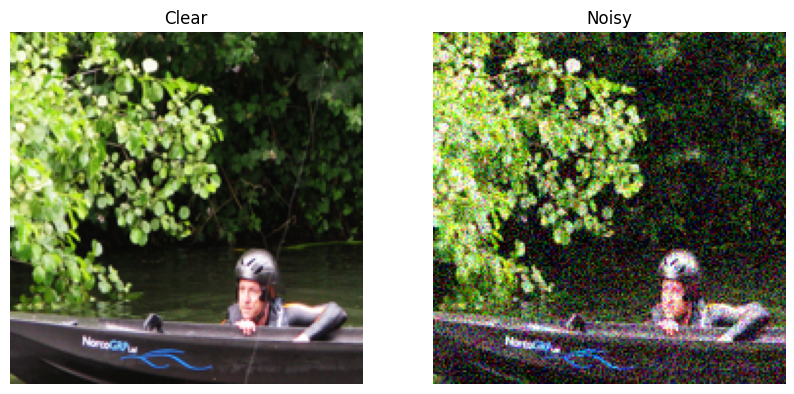

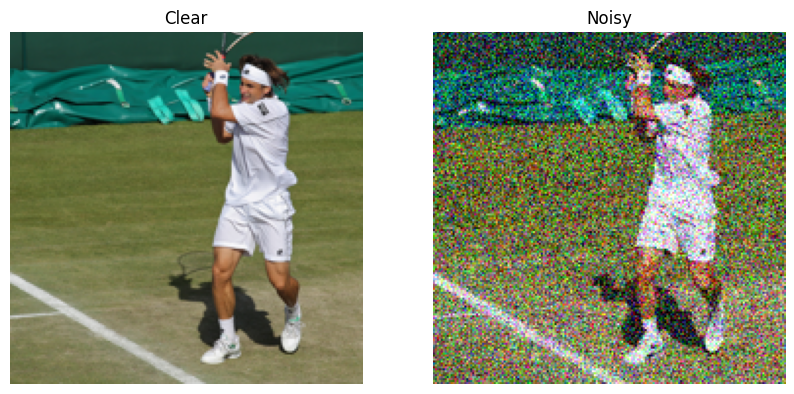

In [7]:
for counter in range(10):
    display_images(images[counter], 'Clear', images_noisy[counter], 'Noisy') 

# Classifier

## Data split

## 'Clean' = 0 | 'Noisy' = 1

In [8]:
x_train = np.concatenate((images[0:900], images_noisy[900:1800]))
y_train = np.concatenate((np.zeros(900), np.ones(900)))
x_test = np.concatenate((images[1800:1900], images_noisy[1900:2000]))
y_test = np.concatenate((np.zeros(100), np.ones(100)))


In [9]:
indices_train = np.random.permutation(len(x_train))

x_train = x_train[indices_train]
y_train = y_train[indices_train]

indices_test = np.random.permutation(len(x_test))

x_test = x_test[indices_test]
y_test = y_test[indices_test]

## Train

In [22]:
def create_model(input_shape=(180, 180, 3)):
    model = Sequential()

    model.add(layers.Input(shape=input_shape))
    model.add(layers.Rescaling(1./255)) 

    model.add(layers.Conv2D(16, (3, 3), padding='same', activation='relu'))
    model.add(layers.MaxPooling2D())

    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(16, (3, 3), padding='same', activation='relu'))
    model.add(layers.MaxPooling2D())


    model.add(layers.Flatten())
    model.add(layers.Dense(16, activation='relu'))

    # Couche de sortie
    model.add(layers.Dense(1, activation='sigmoid'))

    # compilation du Modèle
    model.compile(
        optimizer='adam',
        loss='binary_crossentropy',
        metrics=['accuracy']
    )

    model.summary()

    return model

model_fs = create_model()

Model: "sequential_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling_5 (Rescaling)              │ (None, 180, 180, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_14 (Conv2D)                   │ (None, 180, 180, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_14 (MaxPooling2D)      │ (None, 90, 90, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 90, 90, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_15 (Conv2D)                   │ (None, 90, 90, 16)          │           2,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_15 (MaxPooling2D)      │ (None, 45, 45, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_5 (Flatten)                  │ (None, 32400)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 16)                  │         518,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 1)                   │              17 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 521,201 (1.99 MB)

 Trainable params: 521,201 (1.99 MB)

 Non-trainable params: 0 (0.00 B)

In [23]:
checkpoint_path = "weights_from_scratch/model_early/weights-epoch-{epoch:02d}-{val_loss:.2f}.weights.h5"
os.makedirs(os.path.dirname(checkpoint_path), exist_ok=True)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path, save_weights_only=True,
    save_best_only=True, verbose=1 )

# tensorboard callback
log_dir = "logs_fs/fit/" + datetime.datetime.now().strftime("%Y.%m.%d-%H.%M.%S")+"_model"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1, write_graph=True,
    write_images=True, 
    update_freq='epoch', profile_batch=0, 
    embeddings_freq=0)

# Early stopping
cb_early = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', min_delta=0,
    patience=4, verbose=0,
    mode='auto', baseline=None,
    restore_best_weights=False,
    start_from_epoch=0
)

In [24]:
history_fs = model_fs.fit(x_train, y_train,
                            epochs=25, 
                            validation_split=0.2, 
                            callbacks=[cp_callback, tensorboard_callback, cb_early])

Epoch 1/25
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.4969 - loss: 0.7650
Epoch 1: val_loss improved from inf to 0.69740, saving model to weights_from_scratch/model_early/weights-epoch-01-0.70.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 4s 72ms/step - accuracy: 0.4969 - loss: 0.7639 - val_accuracy: 0.4333 - val_loss: 0.6974
Epoch 2/25
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6475 - loss: 0.5445
Epoch 2: val_loss improved from 0.69740 to 0.12997, saving model to weights_from_scratch/model_early/weights-epoch-02-0.13.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 3s 67ms/step - accuracy: 0.6511 - loss: 0.5404 - val_accuracy: 0.9889 - val_loss: 0.1300
Epoch 3/25
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.9856 - loss: 0.0609
Epoch 3: val_loss improved from 0.12997 to 0.03147, saving model to weights_from_scratch/model_early/weights-epoch-03-0.03.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 3s 68ms/step - accuracy: 0.9858 - loss: 0.0602 - val_accuracy: 0.9972 - val_loss: 0.0315

In [25]:
model_fs.load_weights('weights_from_scratch/model_early/weights-epoch-09-0.01.weights.h5')

## Evaluation

In [26]:
train_loss_fs = history_fs.history['loss']
val_loss_fs = history_fs.history['val_loss']
train_accuracy_fs = history_fs.history['accuracy']
val_accuracy_fs = history_fs.history['val_accuracy']

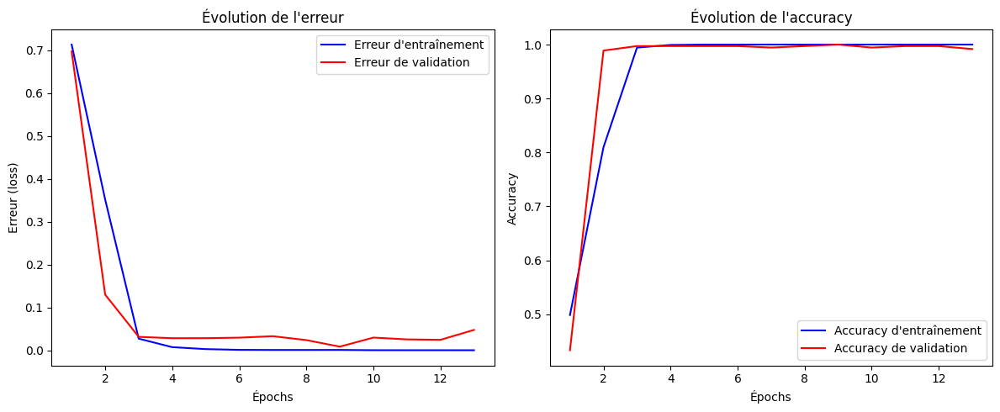

In [27]:
# Création de la figure et des sous-graphes
epochs = range(1, len(train_loss_fs) + 1)

plt.figure(figsize=(12, 5))

# Graphe de l'erreur d'entraînement et de validation
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss_fs, 'b', label='Erreur d\'entraînement')
plt.plot(epochs, val_loss_fs, 'r', label='Erreur de validation')
plt.title('Évolution de l\'erreur')
plt.xlabel('Épochs')
plt.ylabel('Erreur (loss)')
plt.legend()

# Graphe de l'accuracy d'entraînement et de validation
plt.subplot(1, 2, 2)
plt.plot(epochs, train_accuracy_fs, 'b', label='Accuracy d\'entraînement')
plt.plot(epochs, val_accuracy_fs, 'r', label='Accuracy de validation')
plt.title('Évolution de l\'accuracy')
plt.xlabel('Épochs')
plt.ylabel('Accuracy')
plt.legend()

# Afficher les graphiques
plt.tight_layout()
plt.show()

7/7 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step


<Axes: >

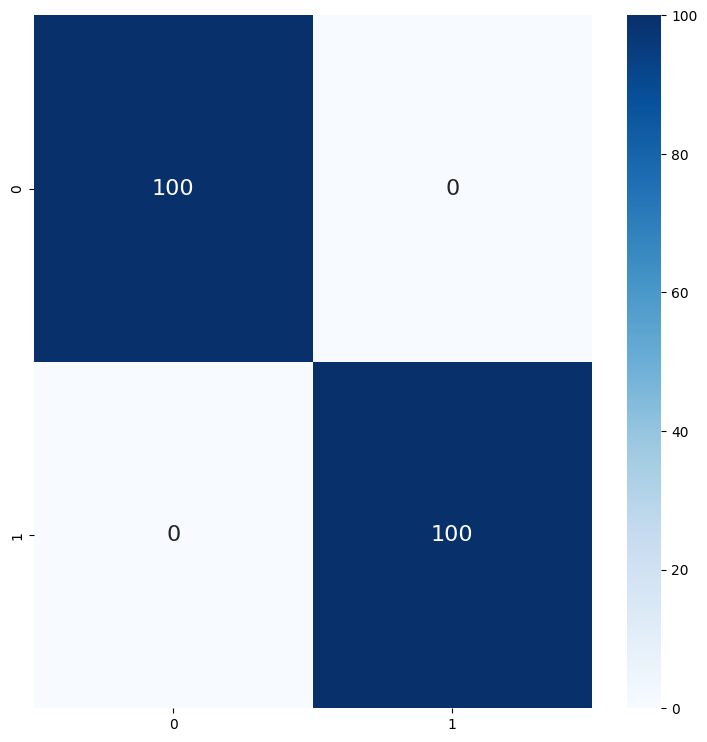

In [32]:
y_pred = (model_fs.predict(x_test) > 0.5).astype(float)

cm = tf.math.confusion_matrix(labels=y_test, predictions=y_pred, num_classes=2).numpy()
plt.figure(figsize=(9, 9))
sns.heatmap(cm, annot=True, fmt="d",cmap="Blues",annot_kws={"size": 16})


# Denoising

## Data split

In [34]:
x_noisy = images_noisy[0:1800]
y_clean = images[0:1800]
x_test_noisy = images_noisy[1800:2000]
y_test_clean = images[1800:2000]


## Normalization

In [35]:
x_noisy = x_noisy/255
y_clean = y_clean/255
x_test_noisy = x_test_noisy/255

## Train

In [36]:
def build_autoencoder(input_shape=(180, 180, 3)):
    # Encoder
    input_img = layers.Input(shape=input_shape)
    
    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same')(input_img)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(64, (3, 3), activation='relu', padding='same', strides=(2, 2))(x)  # Downsample
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(128, (3, 3), activation='relu', padding='same', strides=(2, 2))(x)  # Downsample
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.Conv2D(256, (3, 3), activation='relu', padding='same', strides=(2, 2))(x)  # Downsample
    x = layers.BatchNormalization()(x)
    
    # Decoder
    x = layers.Conv2DTranspose(256, (3, 3), activation='relu', padding='same', strides=(2, 2))(x)  # Upsample
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2DTranspose(128, (3, 3), activation='relu', padding='same', strides=(2, 2))(x)  # Upsample
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2DTranspose(64, (3, 3), activation='relu', padding='same', strides=(2, 2))(x)  # Upsample
    x = layers.BatchNormalization()(x)
    
    x = layers.Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    output_img = layers.Cropping2D(((2, 2), (2, 2)))(x)
    
    # Build model
    autoencoder = Model(input_img, output_img)
    
    return autoencoder

In [37]:
autoencoder_gaussian_noise = build_autoencoder()
autoencoder_gaussian_noise.compile(optimizer='adam', loss='mse')
autoencoder_gaussian_noise.summary()

Model: "functional_62"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 180, 180, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_16 (Conv2D)                   │ (None, 180, 180, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 180, 180, 64)        │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_17 (Conv2D)                   │ (None, 90, 90, 64)          │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 90, 90, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_18 (Conv2D)                   │ (None, 90, 90, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 90, 90, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_19 (Conv2D)                   │ (None, 45, 45, 128)         │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 45, 45, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_20 (Conv2D)                   │ (None, 45, 45, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_4                │ (None, 45, 45, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_21 (Conv2D)                   │ (None, 23, 23, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_5                │ (None, 23, 23, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 46, 46, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 46, 46, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 92, 92, 128)         │         295,040 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_7                │ (None, 92, 92, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 2,111,427 (8.05 MB)

 Trainable params: 2,108,739 (8.04 MB)

 Non-trainable params: 2,688 (10.50 KB)

In [38]:
checkpoint_path = "autoencoder/model_early/weights-epoch-{epoch:02d}-{val_loss:.2f}.weights.h5"
os.makedirs(os.path.dirname(checkpoint_path), exist_ok=True)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path, save_weights_only=True,
    save_best_only=True, verbose=1 )

# tensorboard callback
log_dir = "autoencoder/fit/" + datetime.datetime.now().strftime("%Y.%m.%d-%H.%M.%S")+"_model"
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1, write_graph=True,
    write_images=True, 
    update_freq='epoch', profile_batch=0, 
    embeddings_freq=0)

# Early stopping
cb_early = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', min_delta=0,
    patience=4, verbose=0,
    mode='auto', baseline=None,
    restore_best_weights=False,
    start_from_epoch=0
)

In [39]:
history_gaussian_noise = autoencoder_gaussian_noise.fit(x_noisy, y_clean,
                epochs=30, 
                batch_size=32,  
                validation_split=0.2,
                callbacks=[cp_callback, tensorboard_callback, cb_early]
               )

Epoch 1/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - loss: 0.0405
Epoch 1: val_loss improved from inf to 0.05983, saving model to autoencoder/model_early/weights-epoch-01-0.06.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 331s 7s/step - loss: 0.0401 - val_loss: 0.0598
Epoch 2/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - loss: 0.0111
Epoch 2: val_loss improved from 0.05983 to 0.05691, saving model to autoencoder/model_early/weights-epoch-02-0.06.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 329s 7s/step - loss: 0.0111 - val_loss: 0.0569
Epoch 3/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - loss: 0.0090
Epoch 3: val_loss improved from 0.05691 to 0.04951, saving model to autoencoder/model_early/weights-epoch-03-0.05.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━ 330s 7s/step - loss: 0.0090 - val_loss: 0.0495
Epoch 4/30
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - loss: 0.0080
Epoch 4: val_loss improved from 0.04951 to 0.04756, saving model to autoencoder/model_early/weights-epoch-04-0.05.weights.h5
45/45 ━━━━━━━━━━━━━━━━━━━━

In [48]:
autoencoder_gaussian_noise.load_weights('autoencoder/model_early/weights-epoch-14-0.00.weights.h5')

## Evaluation

In [41]:
train_loss_gaussian_noise = history_gaussian_noise.history['loss']
val_loss_gaussian_noise = history_gaussian_noise.history['val_loss']

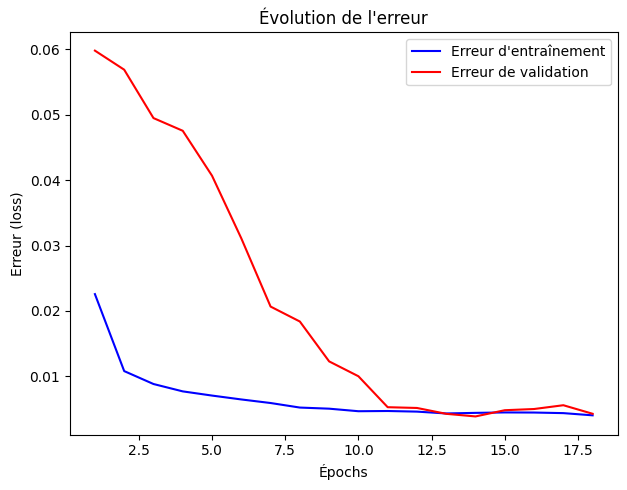

In [42]:
# Création de la figure et des sous-graphes
epochs = range(1, len(train_loss_gaussian_noise) + 1)

plt.figure(figsize=(12, 5))

# Graphe de l'erreur d'entraînement et de validation
plt.subplot(1, 2, 1)
plt.plot(epochs, train_loss_gaussian_noise, 'b', label='Erreur d\'entraînement')
plt.plot(epochs, val_loss_gaussian_noise, 'r', label='Erreur de validation')
plt.title('Évolution de l\'erreur')
plt.xlabel('Épochs')
plt.ylabel('Erreur (loss)')
plt.legend()

# Afficher le graphique
plt.tight_layout()
plt.show()

In [49]:
x_pred = autoencoder_gaussian_noise.predict(x_test_noisy)

7/7 ━━━━━━━━━━━━━━━━━━━━ 6s 772ms/step


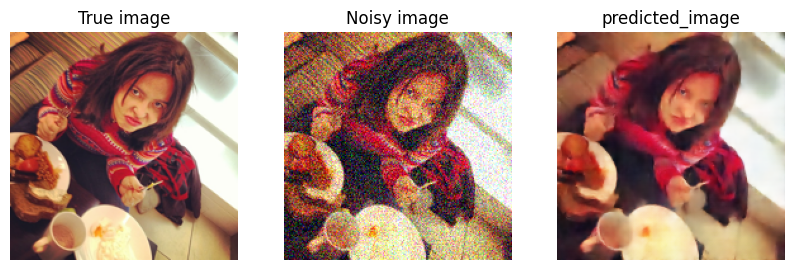

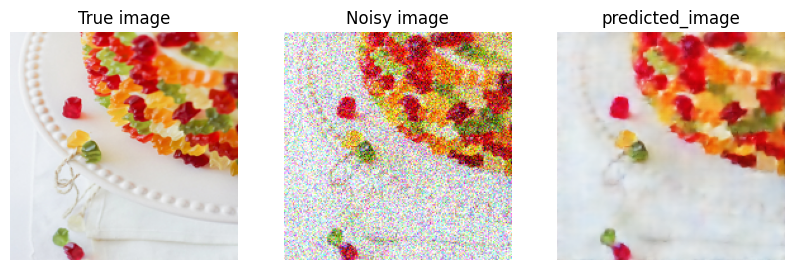

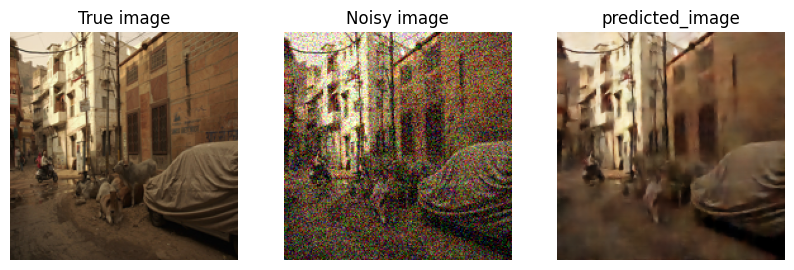

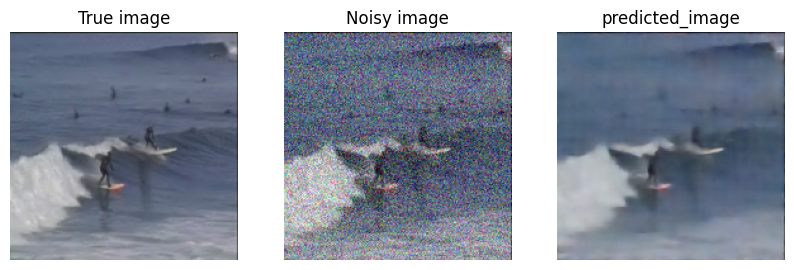

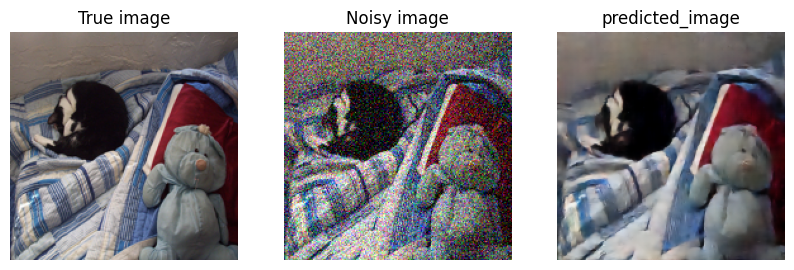

...

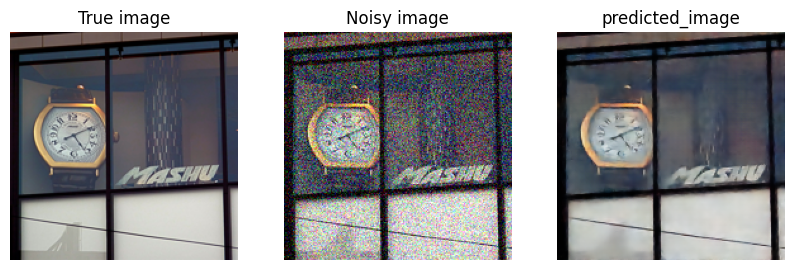

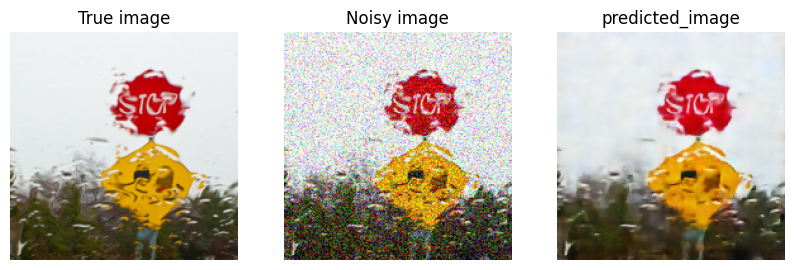

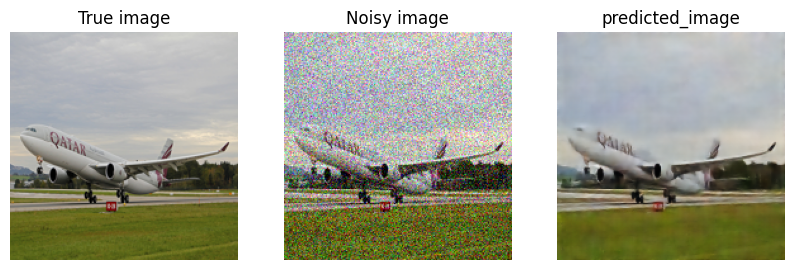

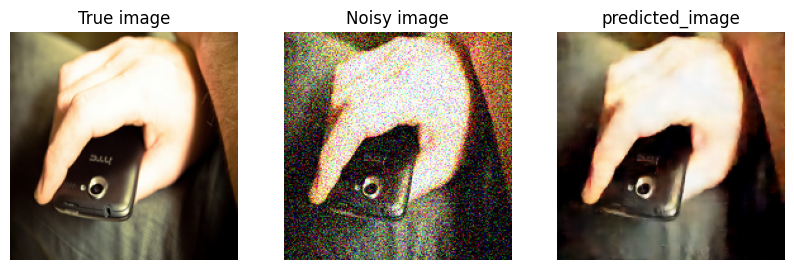

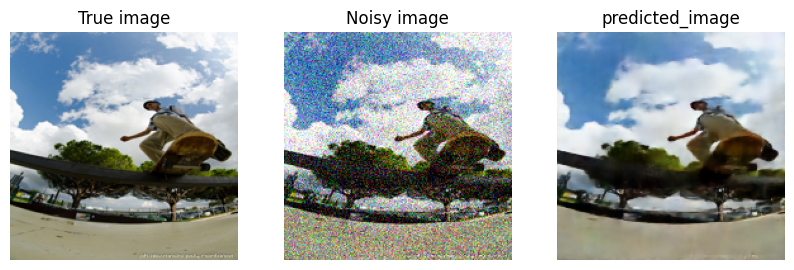

In [50]:
for i in range(30):
    display_images(y_test_clean[i], 'True image',x_test_noisy[i], "Noisy image",x_pred[i]*255, "predicted_image")

# saving models:

In [51]:
model_fs.save('model_fs.keras')

In [52]:
autoencoder_gaussian_noise.save('autoencoder_gaussian_noise.keras')